#**Import Dependencies**

In [1]:
!pip install tensorflow

In [2]:

from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import pandas as pd
import numpy as np
from __future__ import absolute_import, division, print_function

from tensorflow.keras.regularizers import l2

In [3]:
import kagglehub
import os
import matplotlib.pyplot as plt
import numpy as np

import tensorflow as tf
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow import keras
from tensorflow.keras import Sequential, layers
from tensorflow.keras.layers import Layer, RandomContrast, CenterCrop, Conv2D, MaxPool2D, Dense, Flatten, InputLayer, BatchNormalization, Resizing, Rescaling
from tensorflow.keras.callbacks import LearningRateScheduler, EarlyStopping, TensorBoard, ModelCheckpoint, Callback
from tensorboard.plugins.hparams import api as hp
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.metrics import Accuracy,TopKCategoricalAccuracy, CategoricalAccuracy
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Dropout

from google.colab import drive
from tensorflow.keras.models import load_model

In [4]:
SEED = 123

# Set seeds for reproducibility
tf.random.set_seed(SEED)
np.random.seed(SEED)
os.environ['PYTHONHASHSEED'] = str(SEED)

#**Data Pre-Processing**

Downloading the DataSet and setting up the path


In [5]:
path = kagglehub.dataset_download("kritikseth/fruit-and-vegetable-image-recognition")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/fruit-and-vegetable-image-recognition


In [6]:
dataset_path = path

In [7]:
# Printing the dataset path to verify where it is stored
print("Dataset path:", dataset_path)

Dataset path: /kaggle/input/fruit-and-vegetable-image-recognition


In [8]:
train_dir = os.path.join(dataset_path, 'train')
test_dir = os.path.join(dataset_path, 'test')
validation_dir = os.path.join(dataset_path, 'validation')
print(train_dir)
print(test_dir)
print(validation_dir)

/kaggle/input/fruit-and-vegetable-image-recognition/train
/kaggle/input/fruit-and-vegetable-image-recognition/test
/kaggle/input/fruit-and-vegetable-image-recognition/validation


Loading the DataSet

In [9]:
# Load the training dataset
train_ds = image_dataset_from_directory(
    train_dir,
    seed=123,
    label_mode='categorical',
    image_size=(256, 256),
    batch_size=32
)


Found 3115 files belonging to 36 classes.


In [10]:
# Load the test dataset
test_ds = image_dataset_from_directory(
    test_dir,
    seed=123,
    label_mode='categorical',
    image_size=(256, 256),
)

Found 359 files belonging to 36 classes.


In [11]:
# Load the validation dataset
validation_ds = image_dataset_from_directory(
    validation_dir,
    seed=123,
    label_mode='categorical',
    image_size=(256, 256),
)

Found 351 files belonging to 36 classes.


In [12]:
# Print the structure of the datasets to verify
print("Train dataset:", train_ds)
print("Test dataset:", test_ds)
print("Validation dataset:", validation_ds)

Train dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 36), dtype=tf.float32, name=None))>
Test dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 36), dtype=tf.float32, name=None))>
Validation dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 36), dtype=tf.float32, name=None))>


Data Augumentation

In [13]:
class Bright(Layer):
  def __init__(self):
    super().__init__()


  def call(self, image):
    return tf.image.random_brightness(image, max_delta = 0.02)

In [14]:
augumentation_tf = Sequential([
    Bright(),    # here we are using tf.image as a layer through the above class
    RandomContrast(factor=[0.9, 1.1]),
    CenterCrop(height=int(224 * 0.80), width=int(224 * 0.80))
])

def augu_tf(image, labels):
  return augumentation_tf(image, training = True), labels

In [15]:
augumented_data = train_ds.map(augu_tf, num_parallel_calls = tf.data.AUTOTUNE)

In [16]:
concat_data = train_ds.concatenate(augumented_data)

In [17]:
train_dataset = concat_data.shuffle(buffer_size = 8, reshuffle_each_iteration= True).prefetch(tf.data.AUTOTUNE)

In [18]:
val_dataset = validation_ds.shuffle(buffer_size = 8, reshuffle_each_iteration = True).prefetch(tf.data.AUTOTUNE)

In [19]:
test_dataset = test_ds.shuffle(buffer_size = 8, reshuffle_each_iteration = True).prefetch(tf.data.AUTOTUNE)

Class Names

In [20]:
class_names = train_ds.class_names

Visualizing the DataSet

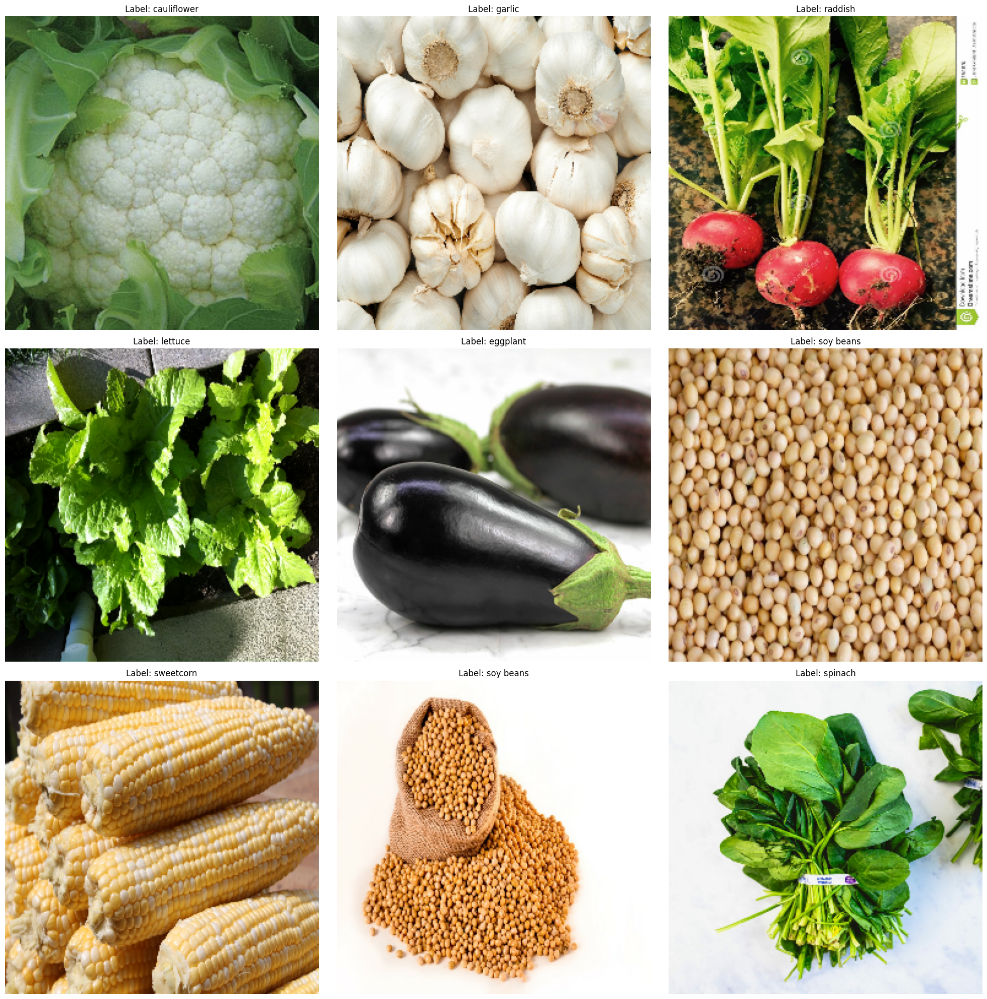

In [23]:
# Show a batch of images from the train dataset
for images, labels in train_dataset.take(1):  # Take one batch
    plt.figure(figsize=(20, 20))

     #Loop over the first 9 images in the batch
    for i in range(9):  # Show 9 images in a 3x3 grid
        plt.subplot(3, 3, i + 1)  # Create a 3x3 grid of images

        # Check the shape of images[i] and ensure it's a NumPy array
        image = images[i].numpy().astype("uint8")  # Convert tensor to NumPy array

        # Ensure that image has the shape (256, 256, 3)
        if image.shape == (256, 256, 3):
            plt.imshow(image)  # Show the i-th image
        else:
            print(f"Image {i} shape is unexpected: {image.shape}")

        # Get the label title from class names
        label_title = class_names[np.argmax(labels[i])]  # Decode the one-hot encoded label
        plt.title(f"Label: {label_title}")
        plt.axis('off')  # Remove axes for better visualization

    plt.tight_layout()  # Ensure images do not overlap
    plt.show()

Setting Tensorflow callback for Visualization of results

In [ ]:
# tensorboard creates an interface where we can visualize the data, graphs, images and results
LOG_DIR = "./logs"

tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = LOG_DIR)

In [ ]:
#creating custom information to be shown on tensorboard
METRIC_DIR = "./logs/metrics"
train_writer = tf.summary.create_file_writer(METRIC_DIR)

#**Hyperparameter Tunning**

In [ ]:
resize_rescale_layer = Sequential([
    Resizing(256, 256),
    Rescaling(1./255)
])

In [ ]:
def model_tune(hparams):
  model_hpt = Sequential([
      InputLayer(input_shape = (256, 256, 3)),
      resize_rescale_layer,

      Conv2D(32, (3, 3), activation = 'relu'),
      BatchNormalization(),
      MaxPool2D((2, 2), strides = 2),

      Conv2D(64, (3, 3), activation = 'relu'),
      BatchNormalization(),
      MaxPool2D((2, 2), strides = 2),


      Conv2D(32, (3, 3), activation = 'relu'),
      BatchNormalization(),
      MaxPool2D((2, 2), strides = 2),

      Flatten(),


      Dense(hparams['num_units_1'], activation = "relu"),
      BatchNormalization(),
      Dropout(0.2),


      Dense(hparams['num_units_2'], activation = "relu"),
      BatchNormalization(),

      Dense(36, activation = "softmax")
  ])

  model_hpt.compile(optimizer = Adam(learning_rate = 0.001), loss = CategoricalCrossentropy(),
                    metrics = [CategoricalAccuracy(name = "accuracy"), TopKCategoricalAccuracy(k=2, name = "top_k_accuracy")])

  model_hpt.fit(train_dataset, epochs=1)

  evaluation_results = model_hpt.evaluate(val_dataset)

  loss, accuracy, top_k_accuracy = evaluation_results


  return loss, accuracy, top_k_accuracy

In [ ]:
A_HP_NUM_UNITS_1 = hp.HParam("num_units_1", hp.Discrete([7200 ]))
A_HP_NUM_UNITS_2 = hp.HParam("num_units_2", hp.Discrete([1800, 900, 512]))

In [ ]:
B_HP_NUM_UNITS_1 = hp.HParam("num_units_1", hp.Discrete([4096 ]))
B_HP_NUM_UNITS_2 = hp.HParam("num_units_2", hp.Discrete([1800, 900, 512]))

In [ ]:
def hyperparameter_tunning(hparam_set, set_name):
  run_number = 0
  for num_units_1 in hparam_set[0].domain.values:
    for num_units_2 in hparam_set[1].domain.values:


            hparams = {
                'num_units_1': num_units_1,
                'num_units_2': num_units_2,


            }
            file_writer = tf.summary.create_file_writer('logs/hparams-'+ set_name + str(run_number))

            with file_writer.as_default():
                hp.hparams(hparams)
                loss, accuracy, top_k_accuracy = model_tune(hparams)
                tf.summary.scalar('accuracy', accuracy, step = 0)
                tf.summary.scalar('loss', loss, step=0)
                tf.summary.scalar('top_k_accuracy', top_k_accuracy, step=0)  # Log top_k_accuracy
            print("For the run {}, hparams num_units_1:{}, num_units_2:{}".format(run_number, hparams['num_units_1'], hparams['num_units_2'],
                                                              ))
            run_number += 1


In [ ]:
hyperparameter_tunning([A_HP_NUM_UNITS_1, A_HP_NUM_UNITS_2], "A")

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


196/196 ━━━━━━━━━━━━━━━━━━━━ 2134s 11s/step - accuracy: 0.2086 - loss: 3.1318 - top_k_accuracy: 0.3368
11/11 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.1522 - loss: 2.9871 - top_k_accuracy: 0.2281
For the run 0, hparams num_units_1:7200, num_units_2:512
196/196 ━━━━━━━━━━━━━━━━━━━━ 2174s 11s/step - accuracy: 0.2024 - loss: 3.3151 - top_k_accuracy: 0.3173
11/11 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.0554 - loss: 3.7524 - top_k_accuracy: 0.1222
For the run 1, hparams num_units_1:7200, num_units_2:900
196/196 ━━━━━━━━━━━━━━━━━━━━ 2183s 11s/step - accuracy: 0.1934 - loss: 3.9796 - top_k_accuracy: 0.2939
11/11 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.0767 - loss: 4.6814 - top_k_accuracy: 0.1801
For the run 2, hparams num_units_1:7200, num_units_2:1800


In [ ]:
hyperparameter_tunning([B_HP_NUM_UNITS_1, B_HP_NUM_UNITS_2], "B")

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


196/196 ━━━━━━━━━━━━━━━━━━━━ 1851s 9s/step - accuracy: 0.2191 - loss: 3.1141 - top_k_accuracy: 0.3377
11/11 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.1730 - loss: 2.9733 - top_k_accuracy: 0.2609
For the run 0, hparams num_units_1:4096, num_units_2:512
196/196 ━━━━━━━━━━━━━━━━━━━━ 1866s 9s/step - accuracy: 0.1848 - loss: 3.4219 - top_k_accuracy: 0.2932
11/11 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - accuracy: 0.1108 - loss: 3.6257 - top_k_accuracy: 0.2213
For the run 1, hparams num_units_1:4096, num_units_2:900
196/196 ━━━━━━━━━━━━━━━━━━━━ 1847s 9s/step - accuracy: 0.1841 - loss: 3.7797 - top_k_accuracy: 0.2871
11/11 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.0793 - loss: 3.9397 - top_k_accuracy: 0.1581
For the run 2, hparams num_units_1:4096, num_units_2:1800


In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir="./logs"

Reusing TensorBoard on port 6006 (pid 31017), started 1:43:02 ago. (Use '!kill 31017' to kill it.)

<IPython.core.display.Javascript object>

#**Model Creation**

In [ ]:
#Model Creation

model = Sequential([
    InputLayer(input_shape = (None, None, 3)),
    resize_rescale_layer,

    Conv2D(32, (3, 3), activation = 'relu'),#, kernel_regularizer= l2(0.001), padding='same'
    BatchNormalization(),
    MaxPool2D((2, 2), strides = 2),

    Conv2D(64, (3, 3), activation = 'relu'),
    BatchNormalization(),
    MaxPool2D((2, 2), strides = 2),


    Conv2D(32, (3, 3), activation = 'relu'),
    BatchNormalization(),
    MaxPool2D((2, 2), strides = 2),

    Flatten(),


    Dense(4096, activation = "relu"),
    BatchNormalization(),
    Dropout(0.2),

    Dense(512, activation = "relu"),
    BatchNormalization(),

    Dense(36, activation = "softmax")
])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


In [ ]:
model.compile(optimizer = Adam(learning_rate = 0.01), loss = CategoricalCrossentropy(),
              metrics = [CategoricalAccuracy(name = "catrgorical_accuracy"), TopKCategoricalAccuracy(k=2, name = "top_k_accuracy")])

In [ ]:
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_1 (Sequential)       │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 254, 254, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 254, 254, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 125, 125, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 32)     │        18,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 60, 60, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 28800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 4096)           │   117,968,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 4096)           │        16,384 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 4096)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 512)            │     2,097,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 36)             │        18,468 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 120,141,828 (458.30 MB)

 Trainable params: 120,132,356 (458.27 MB)

 Non-trainable params: 9,472 (37.00 KB)

Checkpoint Callback


In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
checkpoint_path = '/content/drive/MyDrive/CNN Models/Model Checkpoints/Vegetable and Fruits Classification CNN.weights.h5'
epoch_txt_path = '/content/drive/MyDrive/CNN Models/Model Checkpoints/Vegetable and Fruits Classification CNN last_epoch.txt'

In [ ]:
print("Weights exist:", os.path.exists(checkpoint_path ))
print("Epoch file exists:", os.path.exists(epoch_txt_path))

Weights exist: True
Epoch file exists: True


In [ ]:
initial_epoch = 0
if os.path.exists(checkpoint_path ) and os.path.exists(epoch_txt_path):
    print("Checkpoint and epoch file found. Restoring model...")
    with open(epoch_txt_path, 'r') as f:
        content = f.read().strip()
        if content.isdigit():
            initial_epoch = int(content)
            print(f"Resuming from epoch {initial_epoch}")
        else:
            print("Epoch file is invalid.")
else:
    print("Checkpoint or epoch file not found. Starting from scratch.")

Checkpoint and epoch file found. Restoring model...
Resuming from epoch 19


In [ ]:
# Load model weights if they exist
if os.path.exists(checkpoint_path):
    print("Loading weights from checkpoint...")
    model.load_weights(checkpoint_path)
else:
    print("No weights to load.")


Loading weights from checkpoint...


In [ ]:
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only= True,
    save_freq= "epoch", # Save at end of each epoch
    save_best_only = False,
    verbose=1
)


In [ ]:
# Custom callback to save epoch number after every epoch
class SaveEpochCallback(Callback):
    def on_epoch_end(self, epoch, logs=None):
        with open(epoch_txt_path, 'w') as f:
            f.write(str(epoch + 1))
        print(f"Epoch {epoch + 1} saved.")

Setting up Learning Rate Scheduler


In [ ]:
#not used
def scheduler(epoch, lr):
  if epoch <= 10:
    learning_rate = lr
  else:
    learning_rate = lr * tf.math.exp(-0.1).numpy()
    learning_rate = tf.math.maximum(learning_rate, 0.0001).numpy()
  with train_writer.as_default():
    tf.summary.scalar("learning_rate", data = learning_rate, step = epoch)
  return learning_rate

scheduler_callback = LearningRateScheduler(scheduler, verbose = 1)

Setting up Early Stopping CallBack

In [ ]:
#it will stop the training early if val_loss is not reducing for 2 epochs and will store the latest weights
es_callback = EarlyStopping(
    monitor = "val_loss", min_delta = 0, patience = 6, verbose = 1,
     baseline = None, restore_best_weights = False
)

Setting Up Tensorboard CallBack

In [ ]:
# tensorboard creates an interface where we can visualize the data, graphs, images and results

tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = LOG_DIR)

Training The Model

In [ ]:
history = model.fit(train_dataset, validation_data = val_dataset, epochs=30,
                    initial_epoch=initial_epoch, callbacks=[scheduler_callback, es_callback, tensorboard_callback,
                                                            checkpoint_callback, SaveEpochCallback()])


Epoch 20: LearningRateScheduler setting learning rate to 0.006703200750052929.
Epoch 20/30
196/196 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - catrgorical_accuracy: 0.9091 - loss: 0.2931 - top_k_accuracy: 0.9685
Epoch 20: saving model to /content/drive/MyDrive/CNN Models/Model Checkpoints/Vegetable and Fruits Classification CNN.weights.h5
Epoch 20 saved.
196/196 ━━━━━━━━━━━━━━━━━━━━ 1954s 10s/step - catrgorical_accuracy: 0.9088 - loss: 0.2939 - top_k_accuracy: 0.9683 - val_catrgorical_accuracy: 0.8376 - val_loss: 0.6480 - val_top_k_accuracy: 0.9288 - learning_rate: 0.0067

Epoch 21: LearningRateScheduler setting learning rate to 0.006065306719392538.
Epoch 21/30
196/196 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - catrgorical_accuracy: 0.8949 - loss: 0.3285 - top_k_accuracy: 0.9598
Epoch 21: saving model to /content/drive/MyDrive/CNN Models/Model Checkpoints/Vegetable and Fruits Classification CNN.weights.h5
Epoch 21 saved.
196/196 ━━━━━━━━━━━━━━━━━━━━ 1997s 10s/step - catrgorical_accuracy: 0.8946 - los

In [ ]:
%load_ext tensorboard

In [ ]:
#visualization of tensorboard after call call back in the fit
%tensorboard --logdir="./logs"

<IPython.core.display.Javascript object>

Model Evaluation

In [ ]:
model.evaluate(test_dataset)

12/12 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - catrgorical_accuracy: 0.9731 - loss: 0.2654 - top_k_accuracy: 0.9787


[0.2704905867576599, 0.961002767086029, 0.9749303460121155]

Saving the complete Model

In [ ]:

drive.mount('/content/drive/')

In [ ]:
# Save the model to Google Drive in .h5 format
model.save('/content/drive/MyDrive/CNN Models/Vegetable and Fruits Classification CNN.h5')

Loading and Testing the saved model

In [ ]:

MODEL = load_model('/content/drive/MyDrive/CNN Models/Vegetable and Fruits Classification CNN.h5')

In [ ]:
class_names = train_ds.class_names

In [ ]:
class_names

['apple',
 'banana',
 'beetroot',
 'bell pepper',
 'cabbage',
 'capsicum',
 'carrot',
 'cauliflower',
 'chilli pepper',
 'corn',
 'cucumber',
 'eggplant',
 'garlic',
 'ginger',
 'grapes',
 'jalepeno',
 'kiwi',
 'lemon',
 'lettuce',
 'mango',
 'onion',
 'orange',
 'paprika',
 'pear',
 'peas',
 'pineapple',
 'pomegranate',
 'potato',
 'raddish',
 'soy beans',
 'spinach',
 'sweetcorn',
 'sweetpotato',
 'tomato',
 'turnip',
 'watermelon']

In [ ]:
for images, labels in test_dataset:
  X_test = images.numpy()
  y_test = labels.numpy()
  y_test_class_names = [class_names[np.argmax(label)] for label in y_test]
  break

In [ ]:
y_pred = MODEL.predict(X_test)
y_pred_classes = tf.argmax(y_pred, axis = 1).numpy()

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


In [ ]:
y_true = tf.argmax(y_test, axis = 1).numpy()

In [ ]:
# Get unique class labels from y_true and y_pred_classes
unique_labels = np.unique(np.concatenate((y_true, y_pred_classes)))

# Filter class_names to include only those present in the data
filtered_class_names = [class_names[i] for i in unique_labels]


In [ ]:
Conf_matrix = confusion_matrix(y_true, y_pred_classes)

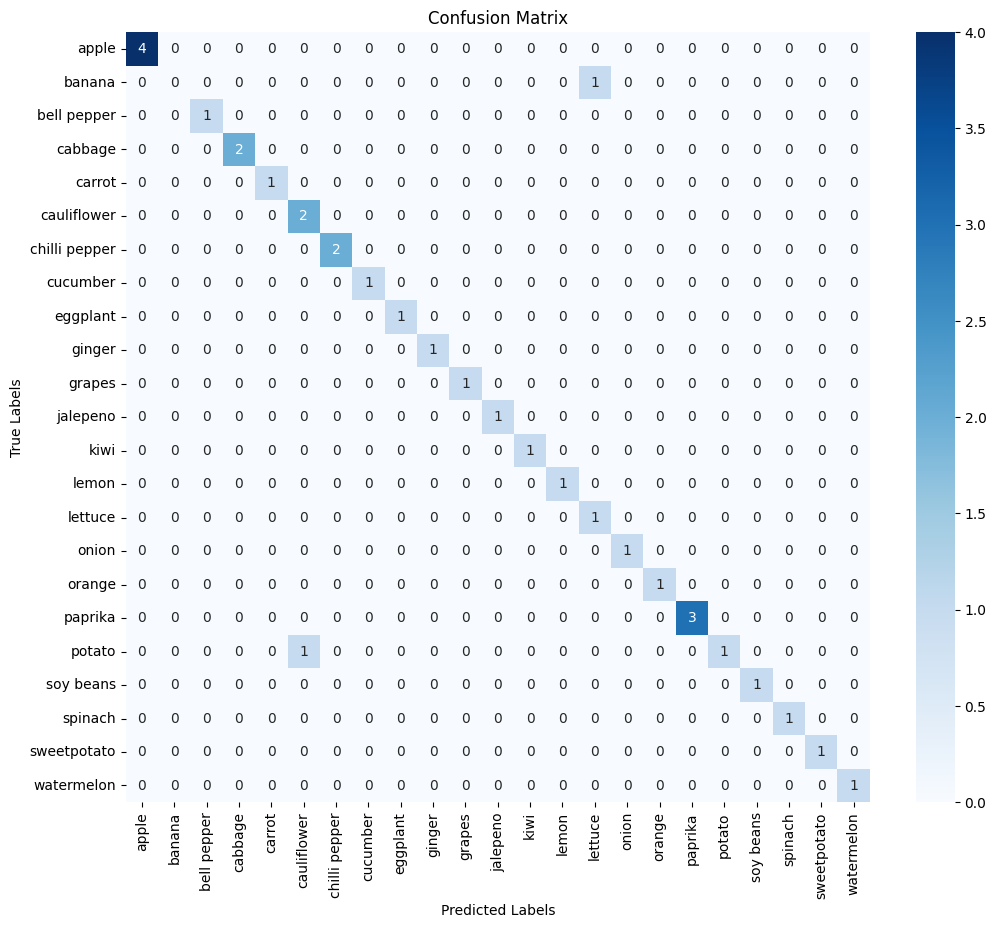

In [ ]:
plt.figure(figsize = (12,10))
sns.heatmap(Conf_matrix, annot = True,  fmt = "d",
            cmap = "Blues", xticklabels = filtered_class_names,
            yticklabels = filtered_class_names)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.yticks(rotation=0)
plt.show()
